         Date   High    Low   Open  Close      Volume   Adj Close
0  2014-01-02  198.5  187.0  198.0  187.0  12694200.0  137.609299
1  2014-01-03  196.0  186.5  187.0  196.0  16987100.0  144.232224
2  2014-01-06  203.0  191.0  195.0  201.0  10294700.0  147.911621
3  2014-01-07  210.0  200.0  205.0  210.0  11479200.0  154.534515
4  2014-01-08  210.0  203.0  208.0  206.0  13653100.0  151.591019
ADVANC data point=1573 
         Date   High    Low   Open  Close     Volume   Adj Close
0  2014-01-02  178.5  166.0  178.5  166.0  9335900.0  128.947006
1  2014-01-03  170.0  166.0  166.0  168.5  9506900.0  130.889008
2  2014-01-06  175.5  165.0  168.0  173.5  9790700.0  134.772934
3  2014-01-07  180.0  173.5  174.0  178.0  5719200.0  138.268524
4  2014-01-08  182.0  177.5  179.0  177.5  9392300.0  137.880112
BBL data point=1573 
         Date  High   Low  Open  Close      Volume  Adj Close
0  2014-01-02  8.65  8.20  8.60   8.20  42998900.0   5.908451
1  2014-01-03  8.10  7.85  8.00   7.95  78845

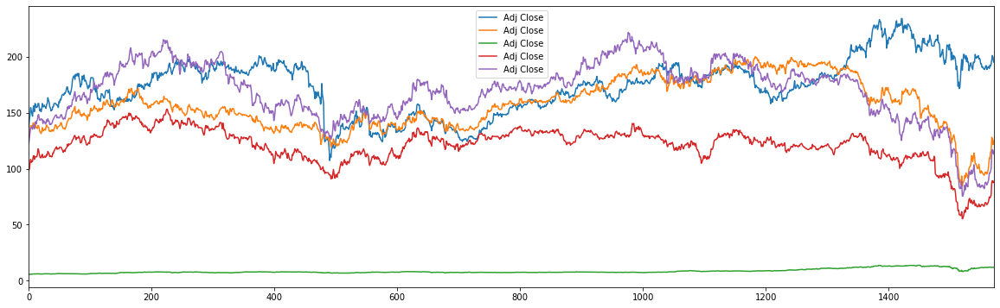

In [88]:
import os, sys
import pandas as pd
import numpy as np

os.chdir("/home/jovyan")
# print(os.getcwd(), os.listdir())

"""
         Date   High    Low   Open  Close      Volume   Adj Close
0  2014-01-02  198.5  187.0  198.0  187.0  12694200.0  137.609299
...
"""

ticker = ['ADVANC', 'BBL', 'BTS', 'SCB', 'KBANK']

dataset = {}

for s in ticker:
    dataFile = "historical/%s.csv" % s
    df = pd.read_csv(dataFile)

    # Defer fixing index to date column
    # df = pd.read_csv(dataFile, index_col=0)
    # df.index = pd.to_datetime(df.index)
    
    df['Adj Close'].plot(legend=True)
    print(df.head())
    print("%s data point=%s " % (s,len(df)))
    dataset[s] = df

In [89]:
df = dataset['ADVANC']
df

,Date,High,Low,Open,Close,Volume,Adj Close
0,2014-01-02,198.5,187.0,198.0,187.0,12694200.0,137.609299
1,2014-01-03,196.0,186.5,187.0,196.0,16987100.0,144.232224
2,2014-01-06,203.0,191.0,195.0,201.0,10294700.0,147.911621
3,2014-01-07,210.0,200.0,205.0,210.0,11479200.0,154.534515
4,2014-01-08,210.0,203.0,208.0,206.0,13653100.0,151.591019
...,...,...,...,...,...,...,...
1568,2020-06-04,199.0,194.0,195.0,197.0,17562000.0,197.000000
1569,2020-06-05,203.0,197.5,197.5,201.0,20702000.0,201.000000
1570,2020-06-08,203.0,199.5,203.0,199.5,8906700.0,199.500000
1571,2020-06-09,202.0,195.0,200.0,195.0,10651200.0,195.000000


# Standard deviation of Adj close last N days

In [3]:
# 

# std() function return sample standard deviation over requested axis.
# https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.Series.std.html


"last 50 days", df['Adj Close'][-50:].std()

('last 50 days', 4.2233075344583)

In [4]:
"last 100 days", df['Adj Close'][-100:].std()

('last 100 days', 9.166366763401856)

In [5]:
"last 200 days", df['Adj Close'][-200:].std()

('last 200 days', 14.182333599090125)

In [6]:
df3 = pd.DataFrame() # result data frame


for i in df.index:
    # print(df[i:i+1])
    # print(df.iloc[i])
    
    # New frame to compute statistics
    df2 = df[0:i]
    last50 = df2['Adj Close'][-50:].std()
    last100 = df2['Adj Close'][-100:].std()
    last200 = df2['Adj Close'][-200:].std()
    # print("Standard deviation last 50 days:", last50)
    # print("Standard deviation last 100 days", last100)
    # print("Standard deviation last 200 days", last200)
    # Statistics for date
    res = {'Date': df.iloc[i]['Date'], 
           'Adj Close': df.iloc[i]['Adj Close'], 
           'Last50': last50, 'Last100': last100, 'Last200': last200}
    df3 = df3.append(res , ignore_index=True)

In [7]:
df3

,Adj Close,Date,Last100,Last200,Last50
0,137.609299,2014-01-02,NaN,NaN,NaN
1,144.232224,2014-01-03,NaN,NaN,NaN
2,147.911621,2014-01-06,4.683115,4.683115,4.683115
3,154.534515,2014-01-07,5.220775,5.220775,5.220775
4,151.591019,2014-01-08,7.071079,7.071079,7.071079
...,...,...,...,...,...
1568,197.000000,2020-06-04,9.724341,14.096496,4.331941
1569,201.000000,2020-06-05,9.547176,14.114713,4.308463
1570,199.500000,2020-06-08,9.405857,14.115843,4.389517
1571,195.000000,2020-06-09,9.319460,14.131375,4.351120


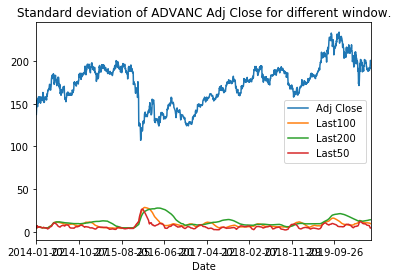

In [8]:
df3.plot(title="Standard deviation of ADVANC Adj Close for different window.", x='Date')

# Standard deviation of Daily Return last N days


In [9]:
df = dataset['ADVANC']
df['Daily Return'] = np.log(df['Adj Close'] / df['Adj Close'].shift(1)) 

In [10]:
# df.index = pd.to_datetime(df['Date'])
df

,Date,High,Low,Open,Close,Volume,Adj Close,Daily Return
0,2014-01-02,198.5,187.0,198.0,187.0,12694200.0,137.609299,NaN
1,2014-01-03,196.0,186.5,187.0,196.0,16987100.0,144.232224,0.047006
2,2014-01-06,203.0,191.0,195.0,201.0,10294700.0,147.911621,0.025190
3,2014-01-07,210.0,200.0,205.0,210.0,11479200.0,154.534515,0.043803
4,2014-01-08,210.0,203.0,208.0,206.0,13653100.0,151.591019,-0.019231
...,...,...,...,...,...,...,...,...
1568,2020-06-04,199.0,194.0,195.0,197.0,17562000.0,197.000000,0.017926
1569,2020-06-05,203.0,197.5,197.5,201.0,20702000.0,201.000000,0.020101
1570,2020-06-08,203.0,199.5,203.0,199.5,8906700.0,199.500000,-0.007491
1571,2020-06-09,202.0,195.0,200.0,195.0,10651200.0,195.000000,-0.022815


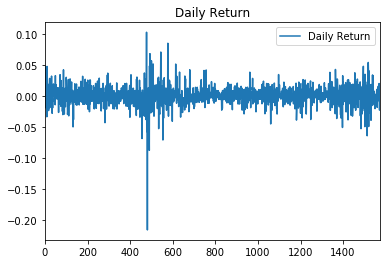

In [11]:
df['Daily Return'].plot(title='Daily Return', x='Date', legend=True)

In [12]:
df.dropna(inplace=True)

In [13]:
df

,Date,High,Low,Open,Close,Volume,Adj Close,Daily Return
1,2014-01-03,196.0,186.5,187.0,196.0,16987100.0,144.232224,0.047006
2,2014-01-06,203.0,191.0,195.0,201.0,10294700.0,147.911621,0.025190
3,2014-01-07,210.0,200.0,205.0,210.0,11479200.0,154.534515,0.043803
4,2014-01-08,210.0,203.0,208.0,206.0,13653100.0,151.591019,-0.019231
5,2014-01-09,208.0,202.0,204.0,203.0,11307400.0,149.383392,-0.014670
...,...,...,...,...,...,...,...,...
1568,2020-06-04,199.0,194.0,195.0,197.0,17562000.0,197.000000,0.017926
1569,2020-06-05,203.0,197.5,197.5,201.0,20702000.0,201.000000,0.020101
1570,2020-06-08,203.0,199.5,203.0,199.5,8906700.0,199.500000,-0.007491
1571,2020-06-09,202.0,195.0,200.0,195.0,10651200.0,195.000000,-0.022815


In [14]:

# std() function return sample standard deviation over requested axis.
# https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.Series.std.html


"last 50 days", df['Daily Return'][-50:].std()

('last 50 days', 0.014467436219191733)

In [15]:
"last 100 days", df['Daily Return'][-100:].std()

('last 100 days', 0.021828155260137438)

In [16]:
"last 200 days", df['Daily Return'][-200:].std()

('last 200 days', 0.01918053155685876)

In [17]:
df3 = pd.DataFrame() # result data frame

for index, row in df.iterrows():
    # print(df[i:i+1])
    # print(df.iloc[0:i])
    
    # New frame to compute statistics
    df2 = df.iloc[0:index]
    last50 = df2['Daily Return'][-50:].std()
    last100 = df2['Daily Return'][-100:].std()
    last200 = df2['Daily Return'][-200:].std()
    # print("Standard deviation last 50 days:", last50)
    # print("Standard deviation last 100 days", last100)
    # print("Standard deviation last 200 days", last200)
    # Statistics for date
    res = {'Date': row['Date'], 
           'Daily Return': row['Daily Return'], 
           'Last50': last50, 'Last100': last100, 'Last200': last200}
    df3 = df3.append(res , ignore_index=True)

In [18]:
df3

,Daily Return,Date,Last100,Last200,Last50
0,0.047006,2014-01-03,NaN,NaN,NaN
1,0.025190,2014-01-06,0.015426,0.015426,0.015426
2,0.043803,2014-01-07,0.011780,0.011780,0.011780
3,-0.019231,2014-01-08,0.030505,0.030505,0.030505
4,-0.014670,2014-01-09,0.031622,0.031622,0.031622
...,...,...,...,...,...
1567,0.017926,2020-06-04,0.021688,0.019319,0.017951
1568,0.020101,2020-06-05,0.021774,0.019370,0.017330
1569,-0.007491,2020-06-08,0.021710,0.019207,0.015829
1570,-0.022815,2020-06-09,0.021820,0.019176,0.015571


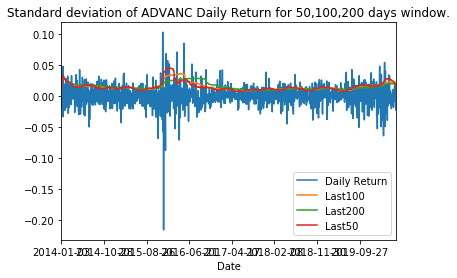

In [19]:
df3.plot(title="Standard deviation of ADVANC Daily Return for 50,100,200 days window.", x='Date')

In [20]:
# Std.Dev of whole period
df.index = pd.to_datetime(df['Date'])

all_data = df['Daily Return'].std()
all_date

0.016246370700593055

In [21]:
# Std.Dev of 2014
s2014 = df['2014-01-01':'2014-12-30']['Daily Return'].std()
s2014

0.01570651250540157

In [22]:
# Std.Dev of 2015
s2015 = df['2015-01-01':'2015-12-30']['Daily Return'].std()
s2015

0.020955676604071275

In [23]:
# Std.Dev of 2016
s2016 = df['2016-01-01':'2016-12-30']['Daily Return'].std()
s2016

0.01955514078738891

In [24]:
# Std.Dev of 2017
s2017 = df['2017-01-01':'2017-12-30']['Daily Return'].std()
s2017

0.010219648491740674

In [47]:
# Std.Dev of 2018
s2018 = df['2018-01-01':'2018-12-30']['Daily Return'].std()
s2018

0.011715421915988814

In [48]:
# Std.Dev of 2019
s2019 = df['2019-01-01':'2019-12-30']['Daily Return'].std()
s2019

0.013650003314249497

In [49]:
# Std.Dev of 2020
s2020 = df['2020-01-01':]['Daily Return'].std()
s2020

0.02134250889327

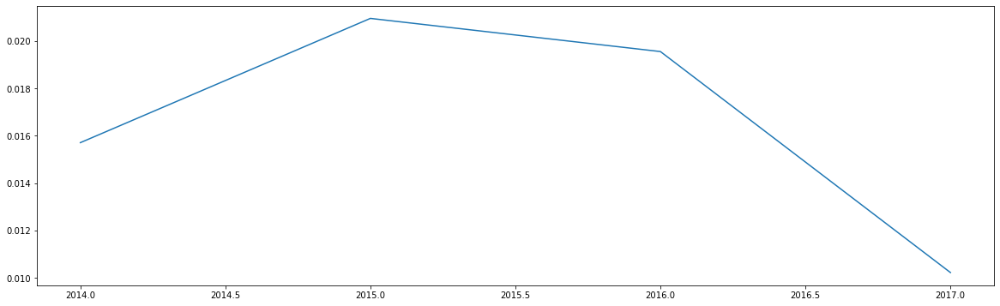

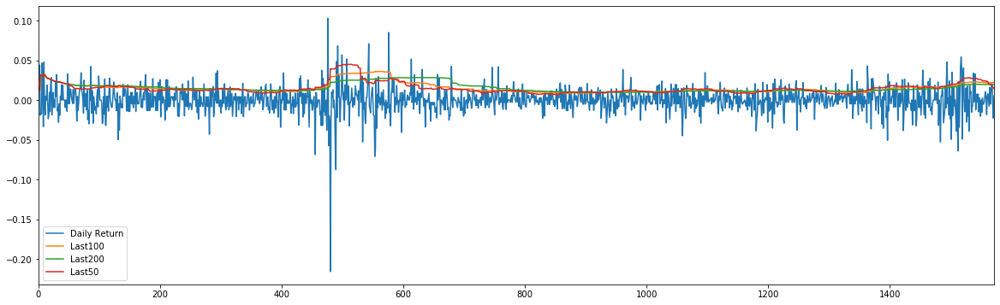

In [25]:

import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rcParams['figure.figsize'] = (20, 6)
mpl.rcParams['axes.grid'] = False


x = [2014, 2015, 2016, 2017]
y = [s2014, s2015, s2016, s2017]

plt.plot(x,y)
df3.plot()

In [54]:
# Set value of annual standard deviation
df3.loc[df3.Date.between('2014-01-01','2015-01-01'),"Annual"] = s2014
df3.loc[df3.Date.between('2015-01-01','2016-01-01'),"Annual"] = s2015
df3.loc[df3.Date.between('2016-01-01','2017-01-01'),"Annual"] = s2016
df3.loc[df3.Date.between('2017-01-01','2018-01-01'),"Annual"] = s2017
df3.loc[df3.Date.between('2018-01-01','2019-01-01'),"Annual"] = s2018
df3.loc[df3.Date.between('2019-01-01','2020-01-01'),"Annual"] = s2019
df3.loc[df3.Date.between('2020-01-01','2021-01-01'),"Annual"] = s2020
# df3.loc[,"Annual"] = s2014
df3

,Daily Return,Date,Last100,Last200,Last50,Annual
0,0.047006,2014-01-03,NaN,NaN,NaN,0.015707
1,0.025190,2014-01-06,0.015426,0.015426,0.015426,0.015707
2,0.043803,2014-01-07,0.011780,0.011780,0.011780,0.015707
3,-0.019231,2014-01-08,0.030505,0.030505,0.030505,0.015707
4,-0.014670,2014-01-09,0.031622,0.031622,0.031622,0.015707
...,...,...,...,...,...,...
1567,0.017926,2020-06-04,0.021688,0.019319,0.017951,0.021343
1568,0.020101,2020-06-05,0.021774,0.019370,0.017330,0.021343
1569,-0.007491,2020-06-08,0.021710,0.019207,0.015829,0.021343
1570,-0.022815,2020-06-09,0.021820,0.019176,0.015571,0.021343


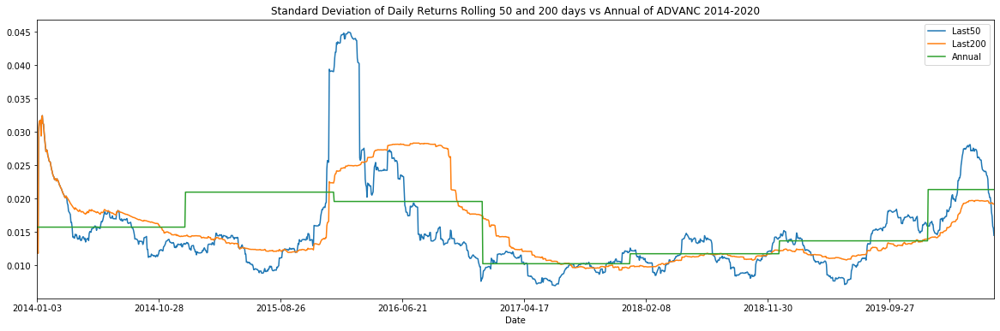

In [63]:
df3[['Date', 'Last50', 'Last200', 'Annual']].plot(title="Standard Deviation of Daily Returns Rolling 50 and 200 days vs Annual of ADVANC 2014-2020", x='Date')

# Compute Standard Deviation of each stock



In [114]:
def compute_standard_deviation_historical_daily_return(ticker='BBL',dataset={}):
    df = dataset[ticker]
    df['Daily Return'] = np.log(df['Adj Close'] / df['Adj Close'].shift(1)) 

    ax = df['Daily Return'].plot(title='Daily Return of %s' % ticker, x='Date', legend=True) # Check plot 1.
    ax.set_ylim(-0.2, 0.2)

    df3 = pd.DataFrame() # result data frame

    for index, row in df.iterrows(): # rolling Std.Dev 50, 100, 200
        # New frame to compute statistics
        df2 = df.iloc[0:index]
        last50 = df2['Daily Return'][-50:].std()
        last100 = df2['Daily Return'][-100:].std()
        last200 = df2['Daily Return'][-200:].std()
        # print("Standard deviation last 50 days:", last50)
        # print("Standard deviation last 100 days", last100)
        # print("Standard deviation last 200 days", last200)
        # Statistics for date (row)
        res = {'Date': row['Date'], 
               'Daily Return': row['Daily Return'], 
               'Last50': last50, 'Last100': last100, 'Last200': last200}
        df3 = df3.append(res , ignore_index=True)


    ax = df3.plot(title="Standard deviation of %s Daily Return for 50,100,200 days window." % ticker, x='Date') # Check plot 2.    
    ax.set_ylim(-0.1, 0.2)

    # Set date index so we can slice periods
    df4 = df.copy()
    df4.index = pd.to_datetime(df4['Date'])

    # Std.Dev of whole period
    all_data = df4['Daily Return'].std()
    all_data
    
    # Std.Dev of 2014
    s2014 = df4['2014-01-01':'2014-12-30']['Daily Return'].std()
    s2014

    # Std.Dev of 2015
    s2015 = df4['2015-01-01':'2015-12-30']['Daily Return'].std()
    s2015

    # Std.Dev of 2016
    s2016 = df4['2016-01-01':'2016-12-30']['Daily Return'].std()
    s2016

    # Std.Dev of 2017
    s2017 = df4['2017-01-01':'2017-12-30']['Daily Return'].std()
    s2017

    # Std.Dev of 2018
    s2018 = df4['2018-01-01':'2018-12-30']['Daily Return'].std()
    s2018

    # Std.Dev of 2019
    s2019 = df4['2019-01-01':'2019-12-30']['Daily Return'].std()
    s2019

    # Std.Dev of 2020
    s2020 = df4['2020-01-01':]['Daily Return'].std()
    s2020

    # Set value of annual standard deviation
    df3.loc[df3.Date.between('2014-01-01','2015-01-01'),"Annual"] = s2014
    df3.loc[df3.Date.between('2015-01-01','2016-01-01'),"Annual"] = s2015
    df3.loc[df3.Date.between('2016-01-01','2017-01-01'),"Annual"] = s2016
    df3.loc[df3.Date.between('2017-01-01','2018-01-01'),"Annual"] = s2017
    df3.loc[df3.Date.between('2018-01-01','2019-01-01'),"Annual"] = s2018
    df3.loc[df3.Date.between('2019-01-01','2020-01-01'),"Annual"] = s2019
    df3.loc[df3.Date.between('2020-01-01','2021-01-01'),"Annual"] = s2020

    df3["Whole Data"] = all_data

    ax = df3[['Date', 'Last50', 'Last200', 'Annual', 'Whole Data']].plot(title="Standard Deviation of Daily Returns Rolling 50 and 200 days vs Annual of %s 2014-2020" % ticker, x='Date') # Check plot 3.
    ax.set_ylim(-0.1, 0.2)
    return df3


2014-01-02 00:00:00


TypeError: cannot do slice indexing on <class 'pandas.core.indexes.datetimes.DatetimeIndex'> with these indexers [2014-01-02 00:00:00] of <class 'pandas._libs.tslibs.timestamps.Timestamp'>

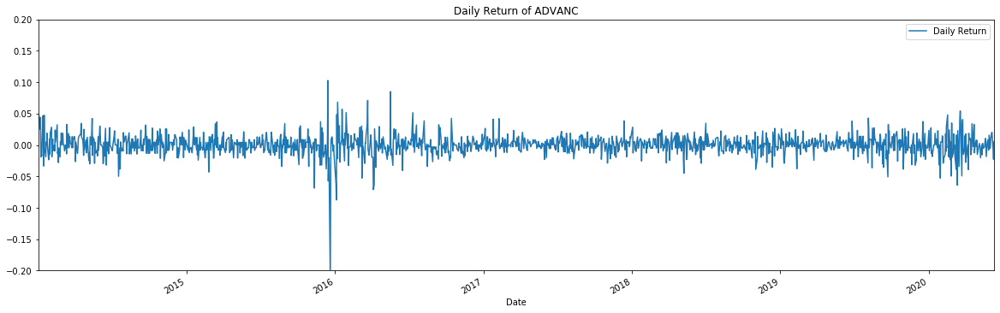

In [113]:
df3 = compute_standard_deviation_historical_daily_return(ticker='ADVANC',dataset=dataset)
df3.head(50)

In [115]:
SET100 = """AAV
ADVANC
AMATA
AOT
AP
BA
BANPU
BBL
BCH
BCP
BDMS
BEAUTY
BEC
BEM
BH
BIG
BLA
BLAND
BTS
CBG
CENTEL
CHG
CK
CKP
COM7
CPALL
CPF
CPN
DELTA
DTAC
EGCO
EPG
GLOBAL
GLOW
GPSC
GUNKUL
HANA
HMPRO
ICHI
IFEC
INTUCH
IRPC
ITD
IVL
KAMART
KBANK
KCE
KKP
KTB
KTC
LH
LHBANK
LPN
MAJOR
MINT
MTLS
PLANB
PSH
PTG
PTT
PTTEP
PTTGC
QH
ROBINS
RS
S
SAMART
SAWAD
SCB
SCC
SCN
SGP
SIRI
SPALI
SPCG
SPRC
STEC
STPI
SUPER
TASCO
TCAP
THAI
THANI
THCOM
TISCO
TKN
TMB
TOP
TPIPL
TRUE
TTA
TTCL
TTW
TU
TVO
UNIQ
VGI
VIBHA
VNG
WHA""".split()

In [118]:
len(SET100)

100

AAV data point=1573 
ADVANC data point=1573 
AMATA data point=1573 
AOT data point=1573 
AP data point=1573 
BA data point=1368 
BANPU data point=1573 
BBL data point=1573 
BCH data point=1573 
BCP data point=1573 
BDMS data point=1573 
BEAUTY data point=1573 
BEC data point=1573 
BEM data point=1573 
BH data point=1573 
BIG data point=1573 
BLA data point=1573 
BTS data point=1573 
CBG data point=1354 
CENTEL data point=1573 
CHG data point=1573 
CK data point=1573 
CKP data point=1573 
CPALL data point=1573 
CPF data point=1573 
CPN data point=1573 
DELTA data point=1573 
EGCO data point=1573 
EPG data point=1333 
GLOBAL data point=1573 
GUNKUL data point=1573 
HANA data point=1573 
HMPRO data point=1573 
ICHI data point=1500 
INTUCH data point=1573 
IRPC data point=1573 
ITD data point=1573 
IVL data point=1573 
KAMART data point=1573 
KBANK data point=1573 
KCE data point=1573 
KKP data point=1573 
KTB data point=1573 
KTC data point=1573 
LH data point=1573 
LPN data point=1573 
M

/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for BDMS


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for BEAUTY


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for BEC


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for BEM


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for BH


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for BIG


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for BLA


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for BTS


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for CBG


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for CENTEL


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for CHG


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for CK


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for CKP


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for CPALL


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for CPF


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for CPN


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for DELTA


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for EGCO


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for EPG


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for GLOBAL


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for GUNKUL


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for HANA


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for HMPRO


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for ICHI


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for INTUCH


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for IRPC


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for ITD


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for IVL


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for KAMART


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for KBANK


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for KCE


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for KKP


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for KTB


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for KTC


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for LH


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for LPN


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for MAJOR


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for MINT


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for PLANB


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for PSH


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for PTG


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for PTT


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for PTTEP


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for PTTGC


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for S


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for SAMART


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for SAWAD


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for SCB


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for SCC


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for SCN


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for SGP


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for SIRI


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for SPALI


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for SPCG


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for SPRC


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for STEC


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for STPI


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for SUPER


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for TASCO


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for TCAP


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for THAI


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for THANI


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for THCOM


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for TISCO


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for TKN


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for TMB


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for TOP


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for TPIPL


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for TRUE


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for TTA


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for TTCL


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for TTW


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for TU


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for TVO


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for UNIQ


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for VGI


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for VIBHA


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for VNG


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


Computing std.dev for WHA


/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:338: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


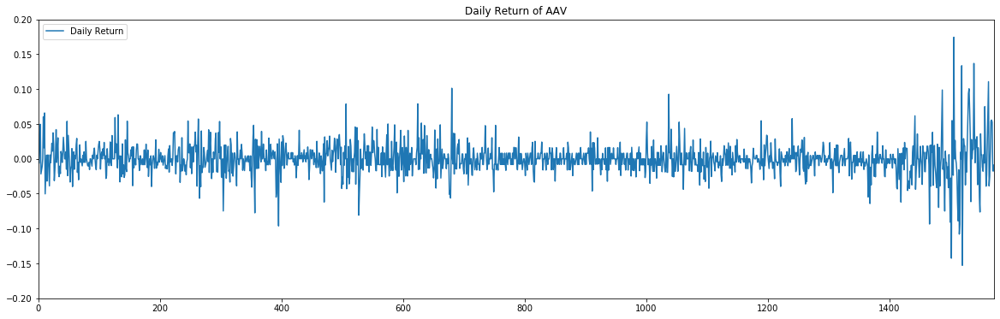

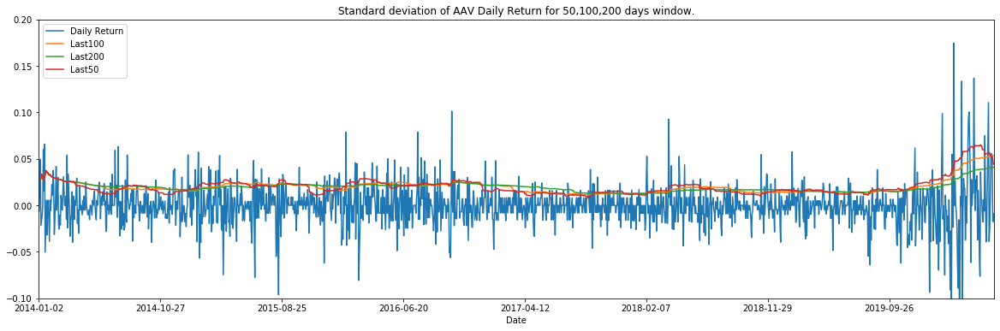

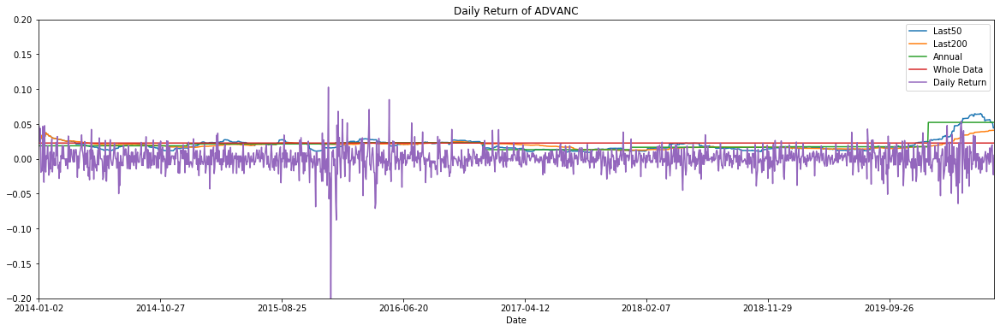

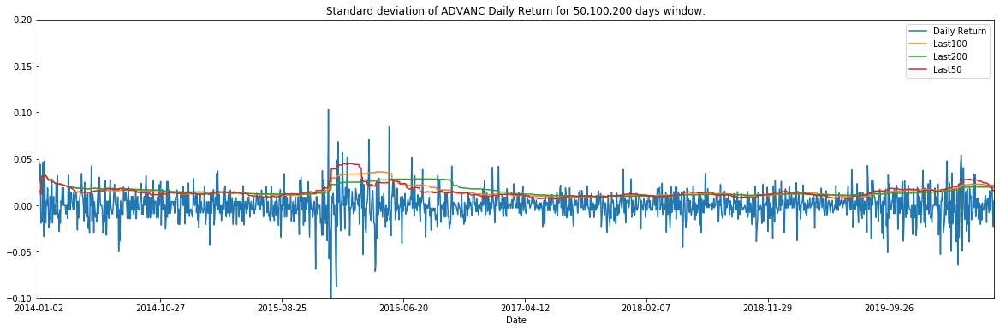

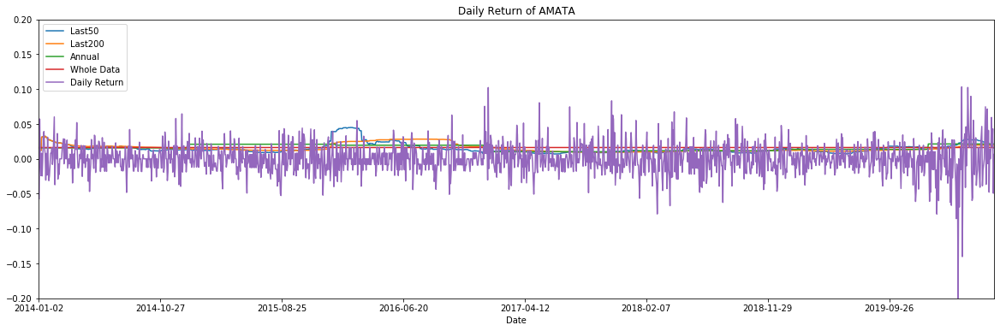

...

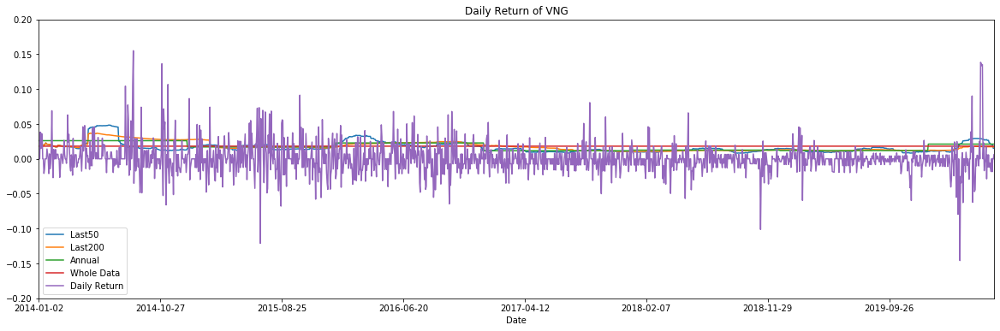

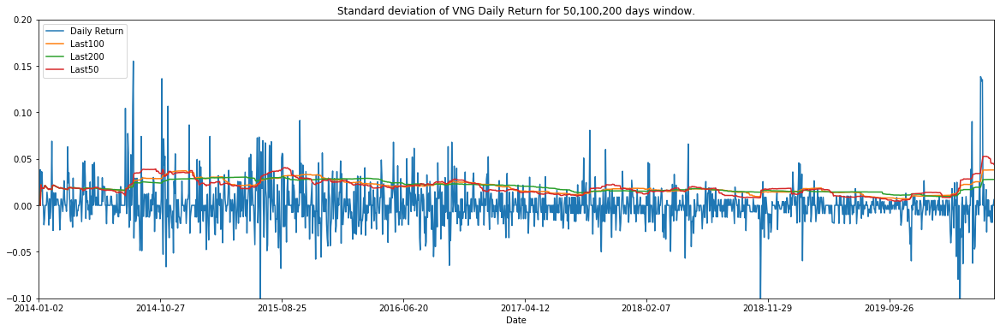

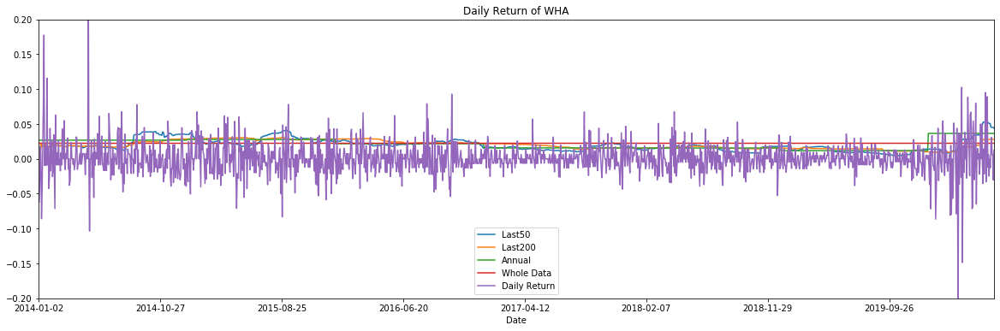

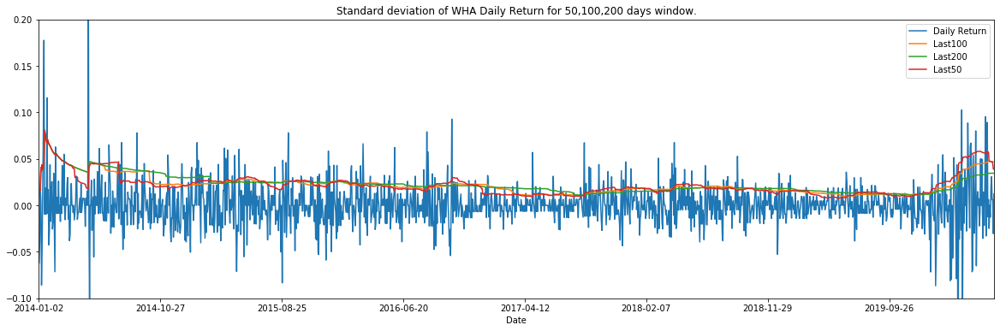

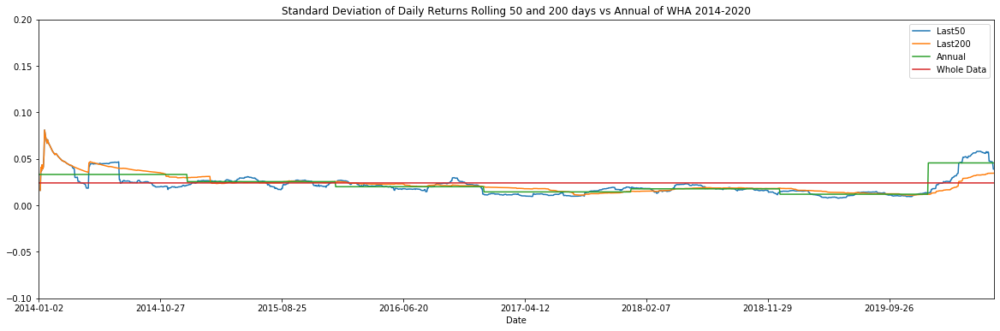

In [122]:
result = {}
dataset = {}

for ticker in SET100:
    dataFile = "historical/%s.csv" % ticker
    try:
        df = pd.read_csv(dataFile)
        print("%s data point=%s " % (ticker,len(df)))
        dataset[ticker] = df
    except FileNotFoundError:
        pass
    
for ticker, df in dataset.items():
    print("Computing std.dev for %s" % ticker)
    output = compute_standard_deviation_historical_daily_return(ticker=ticker,dataset=dataset)
    result[ticker] = output

In [123]:
len(result)

89

In [130]:
df_whole = pd.DataFrame()

for s in result.keys():
    print(result[s]["Whole Data"][0])
    print(result[s].columns)
    res = {'ticker':s, 'std.dev': result[s]["Whole Data"][0],
           'last200': result[s]["Last200"].iloc[-1],
           'last100': result[s]["Last100"].iloc[-1], 'last50': result[s]["Last50"].iloc[-1]
          }
    df_whole = df_whole.append(res, ignore_index=True)

0.022673181186535014
Index(['Daily Return', 'Date', 'Last100', 'Last200', 'Last50', 'Annual',
       'Whole Data'],
      dtype='object')
0.016246370700593055
Index(['Daily Return', 'Date', 'Last100', 'Last200', 'Last50', 'Annual',
       'Whole Data'],
      dtype='object')
0.022281078514371895
Index(['Daily Return', 'Date', 'Last100', 'Last200', 'Last50', 'Annual',
       'Whole Data'],
      dtype='object')
0.018365148281480084
Index(['Daily Return', 'Date', 'Last100', 'Last200', 'Last50', 'Annual',
       'Whole Data'],
      dtype='object')
0.0194393956538205
Index(['Daily Return', 'Date', 'Last100', 'Last200', 'Last50', 'Annual',
       'Whole Data'],
      dtype='object')
0.017815589270397506
Index(['Daily Return', 'Date', 'Last100', 'Last200', 'Last50', 'Annual',
       'Whole Data'],
      dtype='object')
0.02401447797913554
Index(['Daily Return', 'Date', 'Last100', 'Last200', 'Last50', 'Annual',
       'Whole Data'],
      dtype='object')
0.01430654317585743
Index(['Daily Ret

0.03622789419439583
Index(['Daily Return', 'Date', 'Last100', 'Last200', 'Last50', 'Annual',
       'Whole Data'],
      dtype='object')
0.026707154630713707
Index(['Daily Return', 'Date', 'Last100', 'Last200', 'Last50', 'Annual',
       'Whole Data'],
      dtype='object')
0.016077153772406302
Index(['Daily Return', 'Date', 'Last100', 'Last200', 'Last50', 'Annual',
       'Whole Data'],
      dtype='object')
0.03055832919122543
Index(['Daily Return', 'Date', 'Last100', 'Last200', 'Last50', 'Annual',
       'Whole Data'],
      dtype='object')
0.028520927967531178
Index(['Daily Return', 'Date', 'Last100', 'Last200', 'Last50', 'Annual',
       'Whole Data'],
      dtype='object')
0.023013792600558622
Index(['Daily Return', 'Date', 'Last100', 'Last200', 'Last50', 'Annual',
       'Whole Data'],
      dtype='object')
0.01570198230950209
Index(['Daily Return', 'Date', 'Last100', 'Last200', 'Last50', 'Annual',
       'Whole Data'],
      dtype='object')
0.03439607921918229
Index(['Daily Ret

In [131]:
df_whole

,last100,last200,last50,std.dev,ticker
0,0.053406,0.040930,0.044307,0.022673,AAV
1,0.021820,0.019176,0.015571,0.016246,ADVANC
2,0.045346,0.035143,0.038610,0.022281,AMATA
3,0.037934,0.028137,0.030892,0.018365,AOT
4,0.034952,0.028158,0.026522,0.019439,AP
...,...,...,...,...,...
84,0.046489,0.036109,0.044662,0.025013,UNIQ
85,0.042422,0.032631,0.037185,0.022729,VGI
86,0.021744,0.016872,0.015536,0.018166,VIBHA
87,0.038080,0.027884,0.043986,0.022349,VNG


(0.0, 0.1)

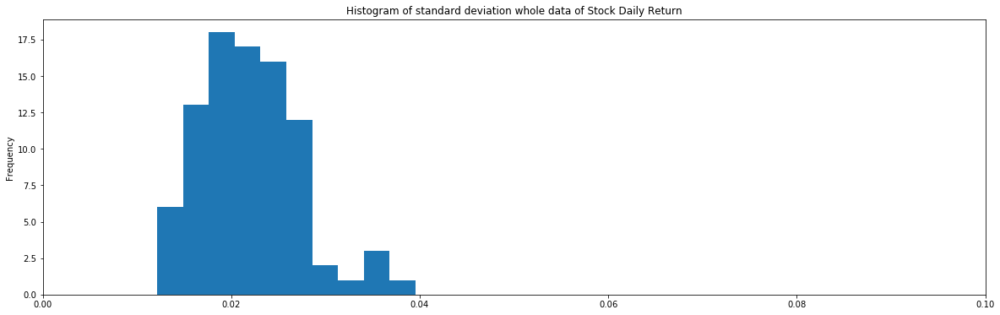

In [145]:
# Variance of each stock

plt.title("Histogram of standard deviation whole data of Stock Daily Return")
ax = df_whole['std.dev'].plot.hist(bins=10)
ax.set_xlim(0.0, 0.1)

(0.0, 0.1)

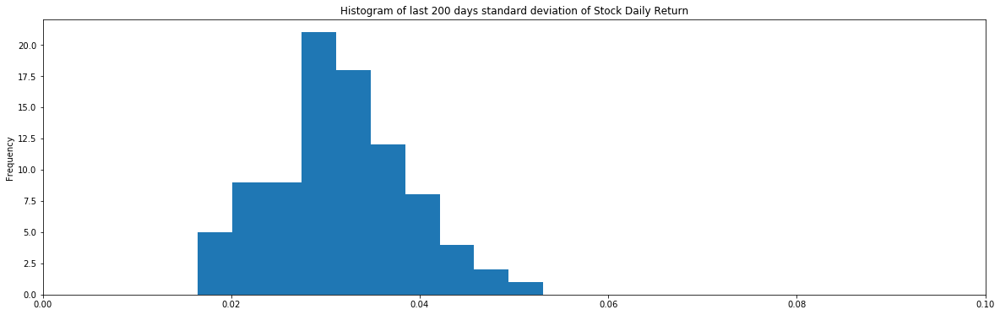

In [146]:

plt.title("Histogram of last 200 days standard deviation of Stock Daily Return")
ax = df_whole['last200'].plot.hist(bins=10)
ax.set_xlim(0.0, 0.1)

(0.0, 0.1)

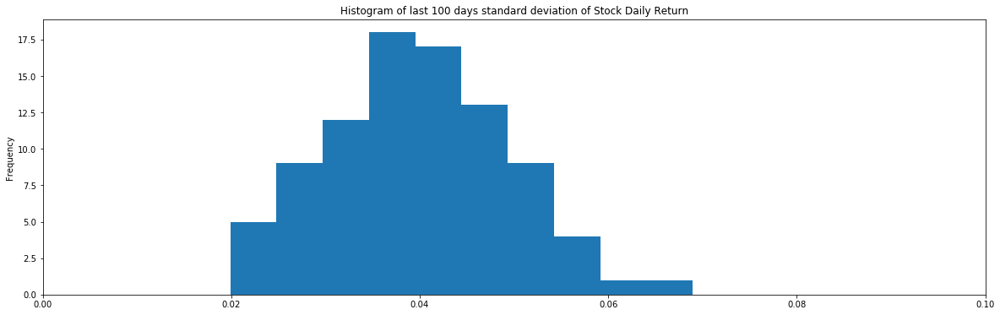

In [147]:
plt.title("Histogram of last 100 days standard deviation of Stock Daily Return")
ax = df_whole['last100'].plot.hist(bins=10)
ax.set_xlim(0.0, 0.1)

(0.0, 0.1)

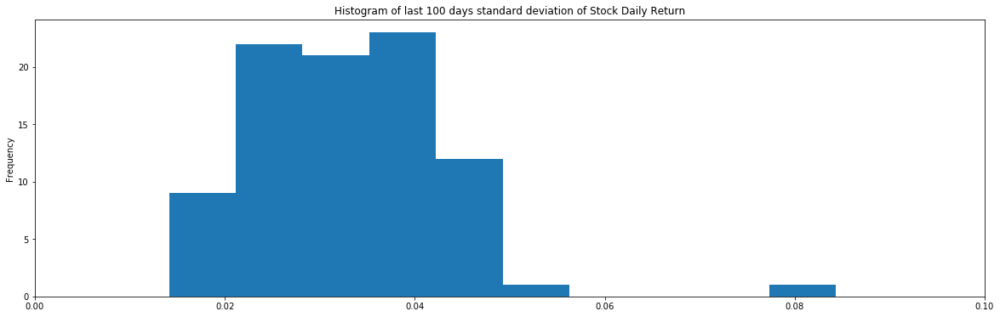

In [148]:
plt.title("Histogram of last 100 days standard deviation of Stock Daily Return")
ax = df_whole['last50'].plot.hist(bins=10)
ax.set_xlim(0.0, 0.1)